<a href="https://colab.research.google.com/github/sandonl/dog-vision/blob/main/dog_vision_breed_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶 End-to-End Multi-class Dog Breed Classifier 

This notebook builds an end-to-end multi-class image classifier using TensorFlow 2.0 and TensorFlow Hub. This project was completed on a former Kaggle competition. 

## 1. Problem 

Identifying the breed of a dog given an image. Being able to identify a breed of a dog simply from an image. 

## 2. Data 

The data we're using is from Kaggle's dog breed identification competition 

https://www.kaggle.com/c/dog-breed-identification/data

## 3. Evaluation 

The evaluation is a file with prediction probabilities for each dog breed of each test image. 

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation 

## 4. Features 

Unstructured dog images - 120 Classess of dogs
* We're dealing with images (unstructured data) - we will use deep learning/ transfer learning 
* There are 120 breeds of dogs which means there are 120 different classes. 
* There is roughly 10,000+ images in the training set
which are labelled 
* There are around 10,000+ images in the test set (these images have no labels and are yet to be predicted) 



In [ ]:
# Unzip the uploaded data into Google Drive 
# !unzip "drive/MyDrive/Dog Vision/dog-breed-identification.zip" -d "drive/MyDrive/Dog Vision"

## Workspace preparation

* Import TensorFlow 2.x ✅
* Import TensorFlow Hub
* Utilise a GPU

In [ ]:
# Import TensorFlow into Colab
import tensorflow as tf 
print("TF version:", tf.__version__)

TF version: 2.4.1


In [ ]:
# Import necessary tools 
import tensorflow as tf
import tensorflow_hub as hub 
print("TF Version:", tf.__version__)
print("TF Hub version:", hub.__version__)

# Check for GPU availability 
print("GPU", "available (YES!)" if tf.config.list_physical_devices("GPU") else "not available")

TF Version: 2.4.1
TF Hub version: 0.11.0
GPU available (YES!)


## Getting our data ready (Transform into Tensors) 

With all machine learning models, our data has to be in numerical format. So we will begin to transform our images into tensors (numerical representations)

Start by accessing our data and checking the labels.

In [ ]:
# Check the labels of our data 
import pandas as pd 
labels_csv = pd.read_csv("drive/MyDrive/Dog Vision/labels.csv")
print(labels_csv.describe())
print(labels_csv.head(5))

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     09288e5c39391b780412561163b10bf5  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [ ]:
labels_csv.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


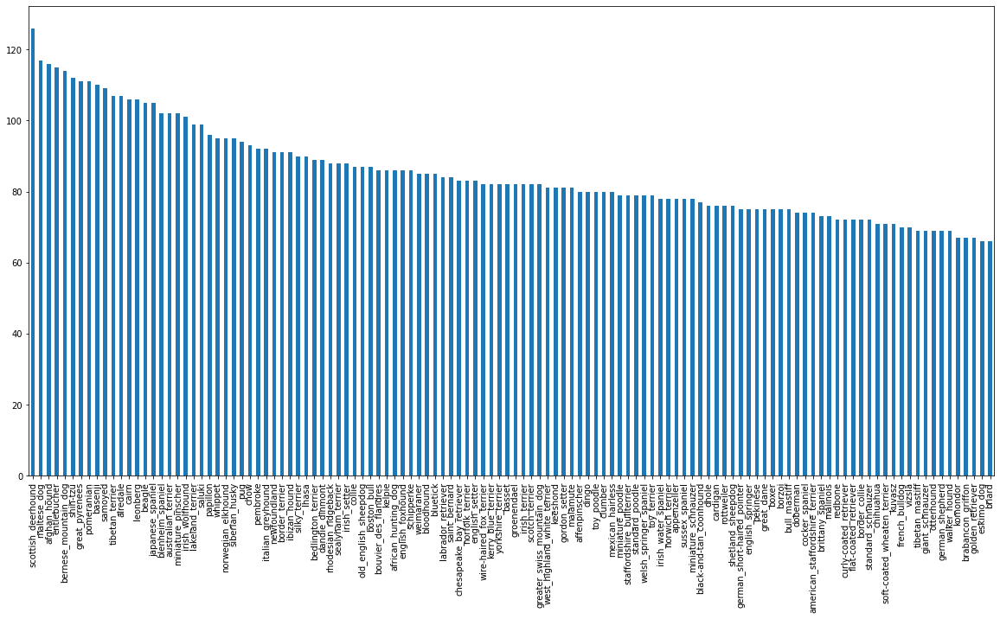

In [ ]:
# How many images of each breed?
labels_csv["breed"].value_counts().plot.bar(figsize=(20,10))

In [ ]:
labels_csv["breed"].value_counts().median()

82.0

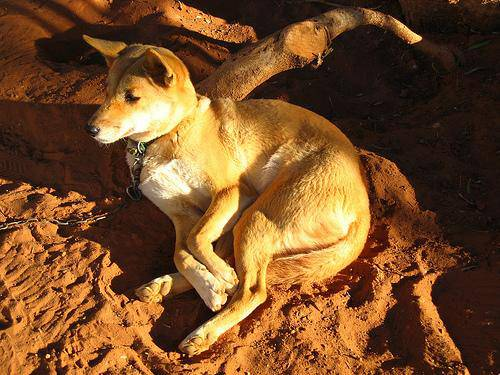

In [ ]:
# Let's view an image using IPython.display
from IPython.display import Image
Image("drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg")

# Getting images and their labels 
Get a list of all our images and their pathnames 

In [ ]:
# Create pathnames from image ID's 
filenames = ["drive/MyDrive/Dog Vision/train/"+ fname + ".jpg" for fname in labels_csv["id"]]

filenames[:10]

['drive/MyDrive/Dog Vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/Dog Vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/Dog Vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/Dog Vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/Dog Vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/Dog Vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/Dog Vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/Dog Vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/Dog Vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/Dog Vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
# Compare number of files compared to training data 
import os 
if len(os.listdir("drive/MyDrive/Dog Vision/train/")) == len(filenames):
  print("Filenames match actual amount of files, Proceed")
else:
  print("Filenames do not match actual amount of files, check the target directory")

Filenames match actual amount of files, Proceed


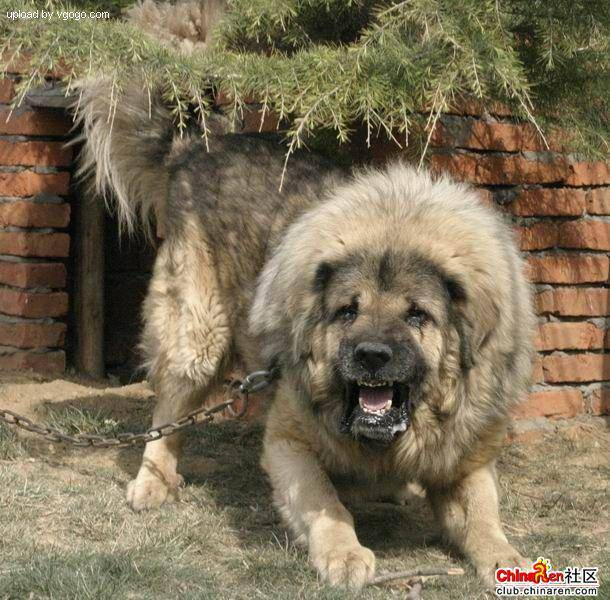

In [ ]:
# Check filenames list works 
Image(filenames[9000])

Prepare labels now that we have training image filepaths

In [ ]:
# Prepare labels 
import numpy as np
labels = labels_csv["breed"].to_numpy()
# labels = np.array(labels) does same thing as above 
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
# See if number of labels matches the number of filenames 
if len(labels) == len(filenames): 
  print("Number of labels matches number of filenames")
else:
  print("Number of labels does not match number of filenames, check data directories")

Number of labels matches number of filenames


In [ ]:
# Find the unique label values 
unique_breeds = np.unique(labels)
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
len(unique_breeds)

120

In [ ]:
# Turn a single label into an array of booleans 
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# Turn every label into a boolean array, for every photoID we have a true for the correct label
boolean_labels = [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
len(boolean_labels)

10222

In [ ]:
# Example: Turning boolean array into integers 
print(labels[0])
print(np.where(unique_breeds == labels[0])) # index where the label occurs 
print(boolean_labels[0].argmax()) # index where label occurs in boolean array 
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


In [ ]:
print(labels[2])
print(boolean_labels[2].astype(int))

pekinese
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set 
Since the dataset from kaggle doesn't come with a validation set, we're going to create our own. 


In [ ]:
# Setup X and Y labels 
X = filenames 
y = boolean_labels

We're going to start experimenting with 1000 images and then increase as needed 

In [ ]:
# Set number of images to use for experimenting 
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [ ]:
# Let's split our data into train and validation sets 
from sklearn.model_selection import train_test_split

# Split them into training and validation of total size NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], 
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(X_val), len(y_train), len(y_val)

(800, 200, 800, 200)

In [ ]:
# View training data 
X_train[:2], y_train[:2]

(['drive/MyDrive/Dog Vision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/MyDrive/Dog Vision/train/0d2f9e12a2611d911d91a339074c8154.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, Fal

## Preprocessing Images (turning images into Tensors)

To preprocess our images into tensors, we will write a function which will achieve the following: 
1. Take an image filepath as input
2. Use TensorFlow to read the file and save this to a variable, `image` 
3. Turn our `image` (a jpg) into Tensors 
4. Normalise our image (convert color channel values from 0-255 to 0-1)
5. Resize the `image` to be a shape of (224, 224) 
6. Return the modified `image` 


Before we do, let's see what importing an image looks like


In [ ]:
# Convert image to a NumPy array 
from matplotlib.pyplot import imread 
image = imread(filenames[37])
image.shape #H, W, CC 

(332, 500, 3)

In [ ]:
image.max(), image.min()

(255, 0)

In [ ]:
# Turn image into a tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 500, 3), dtype=uint8, numpy=
array([[[15, 38, 52],
        [12, 31, 45],
        [14, 28, 41],
        ...,
        [71, 42, 44],
        [70, 41, 43],
        [69, 40, 42]],

       [[11, 34, 48],
        [10, 29, 43],
        [14, 30, 43],
        ...,
        [71, 42, 44],
        [70, 41, 43],
        [69, 40, 42]]], dtype=uint8)>

Now we've seen what an image looks like as a tensor, we will make a function which will allow us to preprocess these.

In [ ]:
# DEFINE image size 
IMG_SIZE = 224 

# Create a function for preprocessing images 
def process_image(image_path):
  """
  Takes an image file path and turns the image into a Tensor. 
  """
  # Read in an image file 
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-255 to 0-1 values (normalisation)
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired value (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])

  return image

## Turning our data into batches 

Why turn our data into batches? 

Let's say you're trying to process 10,000+ images, in one go.. they might not all fit into memory 

So that's why we do about 32 images (batch size) at a time (we can manually adjust the batch size if need be). 

In order to use TensorFlow effectively, we need our data to be in the form of Tensor tuples whichlook like this: 
`(image, label)` 

In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image filepath name and the associated label, processes the image
  and returns a tuple of (image, label) in tensor format. 
  """
  image = process_image(image_path)
  return image, label

In [ ]:
# Demo of the above 
process_image(X[42]), tf.constant(y[42])

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we've got a way to turn our data into tuples of Tensors in the form: `(image, label)`, let's make a function to turn all of our data (`X` & `y`) into batches 

In [ ]:
# Define the batch size, 32 
BATCH_SIZE = 32 

# Create a function to turn data into batches 
def create_data_batches(X, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data of images (X) and label (y) pairs 
  Shuffles the data if it is training data but doesn't shuffle if it's validation data 
  Also accepts test data as input (no labels). 
  """
  # If the data is a test dataset, this means we don't have labels 
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a validation dataset, we don't need to shuffle it 
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(y))) # labels 
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors 
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(y)))
    # Shuffling pathnames and labels before mapping image processor. function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples and assign thems into batches 
    data = data.map(get_image_label)

    # Turn the training data into batches 
    data_batch = data.batch(BATCH_SIZE)
  return data_batch                           


In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out different attributes of our data batches 
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Visualising Data Batches

Our data is now in batches, however, these can be a little hard to understand/ comprehend, let's visualise this 

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch 
def show_25_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch
  """

  # Setup the figure 
  plt.figure(figsize=(10,10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image 
    plt.imshow(images[i])
    # Add the image label as the title 
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn the grid lines off 
    plt.axis("off")

In [ ]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

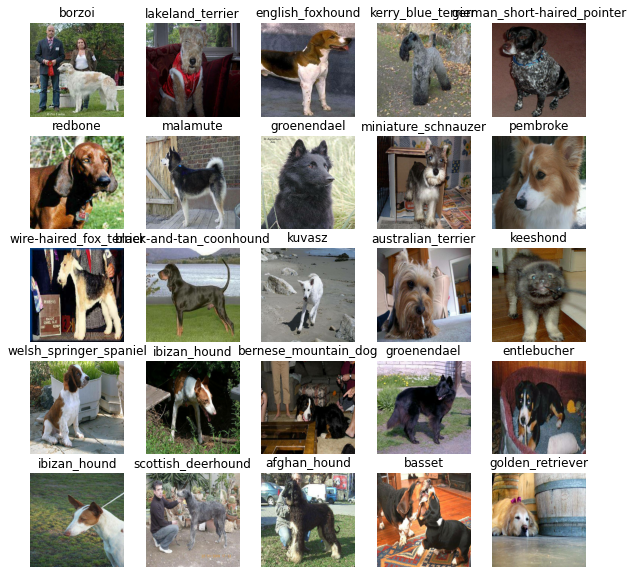

In [ ]:
# Now let's visualise the data in a training batch 
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

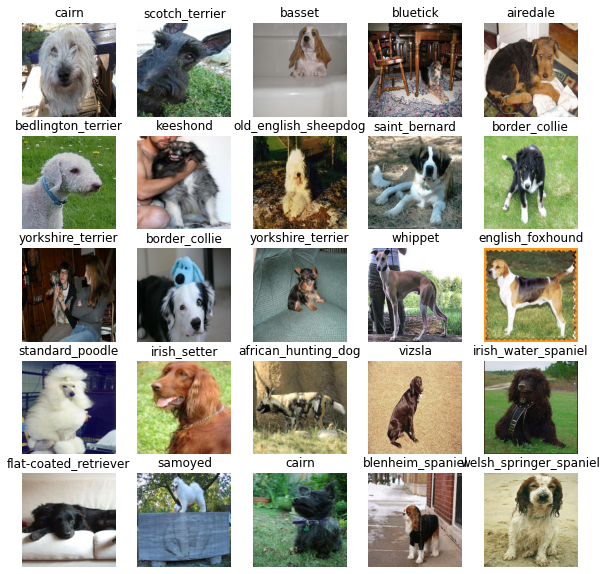

In [ ]:
# Now let's visualise our validation set 
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

In [ ]:
len(train_images), len(train_labels)

(32, 32)

## Building a model 

Before we build a model, there are a few things we need to define: 
* The input shape (our images shape, in the form of Tensors) to our model. 
* The output shape (image labels, in the form of Tensors) of our model. 
* The URL of the model we want to use from TensorFlow Hub
https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# Setup input shape to the model 
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels 

# Setup output shape of our model 
OUTPUT_SHAPE = len(unique_breeds)

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"


Now we've got our inputs, outputs and model ready to go. 
Let's put them together into a Keras deep learning model 

Knowing this, let's create a function which: 
* Takes the input shape, output shape and the model we've chosen as parameters. 
* Defines the layers in a Keras model in sequential fashion (operates sequentially).
* Compiles the model (says it should be evaluated and improved). 
* Build the model (tells the model the input shape it'll be getting) 
* Returns the model. 

In [ ]:
# Create a function which builds a Keras model 
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers 
  model = tf.keras.Sequential([
      hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
      tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                            activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model 
  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_1 (KerasLayer)   (None, 1001)              5432713   
_________________________________________________________________
dense_1 (Dense)              (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


In [ ]:
outputs = np.ones(shape=(1,1, 1280))
outputs

array([[[1., 1., 1., ..., 1., 1., 1.]]])

## Creating callbacks 

Callbacks are helper functions a model can use during training to do such things as save its progress, check progress or stop training early if a model stops improving 

We'll create two callbacks, one for TensorBoard which helps track our models progress and another for early stopping which prevents the model from training for too long.

### TensorBoard Callback

To setup a TensorBoard callback, we need to do 3 things:
1. Load the TensorBoard notebook extension 
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualise our models training logs with the `%tensorboard` magic function (we'll do this after model training) 

In [ ]:
# Load TensorBoard notebook extension 
%load_ext tensorboard 

In [ ]:
import datetime 

# Create a function to build a TensorBoard callback 
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard Logs 
  logdir = os.path.join("drive/MyDrive/Dog Vision/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early Stopping Callback
Early stopping helps stop our model from overfitting by stopping training if a certain evaluation metric stops improving 

https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping


In [ ]:
# Create early stopping callback 
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                   patience=3)

## Training a model (on subset of data)

Our first model is only going to train on 1000 images, to make sure everything is working 

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [ ]:
# Check to make sure we're still on a GPU 
print("GPU", "available (YES!)" if tf.config.list_physical_devices("GPU") else "not available")

GPU available (YES!)


Let's create a function which trains a model 

* Create a model using `create_model()` 
* Setup a TensorBoard callback using `create_tensorboard_callback()` 
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`) and the callbacks which are our helper functions which we would like to use 
* Return the model 

In [ ]:
# Build a function to train and return a trained model. 

def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model 
  model = create_model()

  # Create new TensorBoard session everytime we train a model 
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created 
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  
  # Return the fitted model
  return model

In [ ]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 755s 30s/step - loss: 5.0294 - accuracy: 0.0455 - val_loss: 3.4267 - val_accuracy: 0.2250
Epoch 2/100
25/25 [==============================] - 5s 202ms/step - loss: 1.8610 - accuracy: 0.6468 - val_loss: 2.1768 - val_accuracy: 0.4700
Epoch 3/100
25/25 [==============================] - 5s 202ms/step - loss: 0.5822 - accuracy: 0.9365 - val_loss: 1.6828 - val_accuracy: 0.5400
Epoch 4/100
25/25 [==============================] - 5s 203ms/step - loss: 0.2654 - accuracy: 0.9849 - val_loss: 1.5093 - val_accuracy: 0.5700
Epoch 5/100
25/25 [==============================] - 5s 202ms/step - loss: 0.1526 - accuracy: 0.9956 - val_loss: 1.4501 - val_accuracy: 0.5950
Epoch 6/100
25/25 [==============================] - 5s 205ms/step - loss: 0.1043 - accuracy: 1.0000 - val_loss: 1.3970 - val_accuracy: 0.6000
Epoch 7/100
25/25 [==============================

**Question:** It looks like our model is overfitting as it performs far better on the training set than on the validation set 



### Checking the TensorBoard logs 

The TensorBoard magic function (`%tensorboard`) will access the logs directory that we created earlier and visualise its contents. 

In [ ]:
%tensorboard --logdir drive/MyDrive/Dog\ Vision/logs

<IPython.core.display.Javascript object>

## Making and evaluating predictions using a trained model 

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data, verbose=1)
predictions

7/7 [==============================] - 2s 156ms/step


array([[2.2295908e-04, 2.9132209e-05, 3.9508363e-04, ..., 2.6580508e-05,
        9.2157010e-05, 1.1095241e-02],
       [1.5821275e-03, 1.3493284e-03, 5.6230333e-03, ..., 1.1510568e-03,
        1.4428443e-03, 2.6276623e-04],
       [8.2308834e-06, 1.3879904e-05, 7.3971182e-06, ..., 7.4619522e-05,
        7.1345694e-06, 1.1887916e-05],
       ...,
       [7.5957723e-06, 3.8443995e-05, 1.8110815e-05, ..., 1.1787675e-05,
        1.9462988e-05, 9.1367365e-06],
       [7.9270074e-04, 2.2645992e-04, 3.9975181e-05, ..., 2.2613542e-04,
        1.4354201e-04, 4.9959621e-03],
       [1.3614849e-03, 2.0478234e-05, 4.1878730e-04, ..., 1.4967031e-03,
        7.7194032e-05, 1.0260094e-04]], dtype=float32)

In [ ]:
np.sum(predictions[0])

0.9999999

In [ ]:
# First prediction 
index = 0
print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[0])}")
print(f"Sum: {np.sum(predictions[index])}")
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_breeds[np.argmax(predictions[index])]}")

[2.22959075e-04 2.91322085e-05 3.95083625e-04 3.77843535e-05
 1.81512165e-04 1.19649594e-05 1.42029095e-02 1.22414017e-03
 4.41734192e-05 4.65672580e-04 8.78437204e-05 3.85159910e-05
 8.80418171e-04 4.83606746e-05 3.94739211e-04 4.84830234e-04
 6.23372907e-05 3.14343274e-01 2.74063295e-05 1.05679806e-04
 9.34027834e-04 9.51408147e-05 7.57048974e-06 6.66304782e-04
 5.16781256e-06 1.14320406e-04 3.33918065e-01 5.02532988e-04
 5.84126334e-04 1.05704392e-04 2.41550428e-04 5.95022982e-04
 3.14583303e-04 4.29840075e-05 1.49699204e-04 1.49939107e-02
 7.11128814e-06 9.95539303e-05 1.07981214e-04 3.43642205e-05
 6.92803762e-04 6.58733052e-06 4.25498229e-06 2.16486205e-05
 2.84400230e-05 3.08314309e-04 2.01823877e-05 4.33828973e-04
 8.00749694e-04 6.56473130e-05 1.93314248e-04 5.13053856e-05
 2.13287582e-04 7.43174533e-05 6.12903605e-05 6.05827809e-05
 1.55166534e-04 5.24005899e-03 4.30892804e-04 6.82861730e-02
 1.01504098e-04 9.32611601e-06 3.78996629e-04 8.10464917e-06
 4.68148995e-04 1.031871

Now to convert the above functionality into scale, also to implement the image that the picture is being predicted on

**Note:** Prediction probabilities are also known as confidence levels

In [ ]:
# Turn the prediction probabilities into their respective labels (easier to understand)

def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities 
pred_label = get_pred_label(predictions[33])
pred_label  

'malinois'

Since our validation data is still in a batch dataset, we'll have to unbatchify it to make predictions on the validation images and then compare those predictions to the validation labels (truth labels)

In [ ]:
# Create a function to unbatch a batch dataset 
def un_batchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns seperate arrays 
  of images and labels.
  """
  images = []
  labels = []
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])

  return images, labels

# Unbatchify the validation data
val_images, val_labels = un_batchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

Now we've got ways to get: 
* Prediction labels 
* Validation labels (truth labels)
* Validation images 

Let's make some function to make these all a bit more visual. 

We'll create a function which: 
* Takes an array of prediction probabilities, an array of truth labels and an array of images and integers. 
* Convert the prediction probabilities to a predicted label. 
* Plot the predicted label, its predicted probability, the truth label and the target image on a single plot. 




In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks 
  plt.imshow(image) 
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong 
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change plot title to be predicted, probability of prediction and truth label 
  plt.title("{} {:2.0f}% {}".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)
  



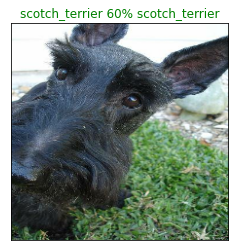

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

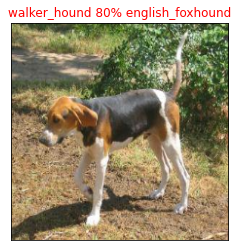

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=42)

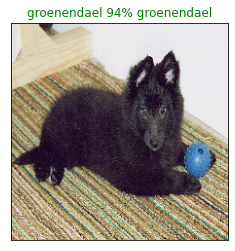

In [ ]:
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images,
          n=77)

Now we've got one function to visualise our models predictions, let's make another to view our models top 10 predictions 

The function will: 
* Take an input of prediction probabilities array and a ground truth array and an integer 
* Find the prediction using `get_pred_label()` 
* Find the top 10:
 * Prediction probabilities indexes 
 * Prediction probabilities values 
 * Prediction labels 
* Plot the top 10 prediction probability values and labels, coloring the true label green


In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n 
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label 
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes 
  top_10_pred_indexes = pred_prob.argsort()[-10::][::-1]

  # Find the top 10 prediction confidence values 
  top_10_pred_values = pred_prob[top_10_pred_indexes]

  # Find the top 10 prediction labels 
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot 
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")
  
  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass



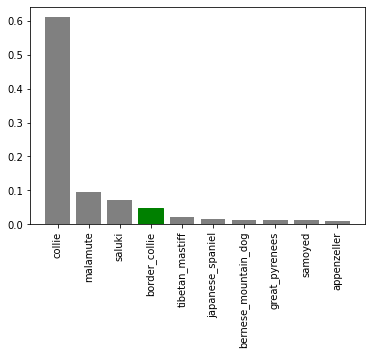

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Now we've got some function to help visualise our predictions and evaluate our model, let's visualise a few: 

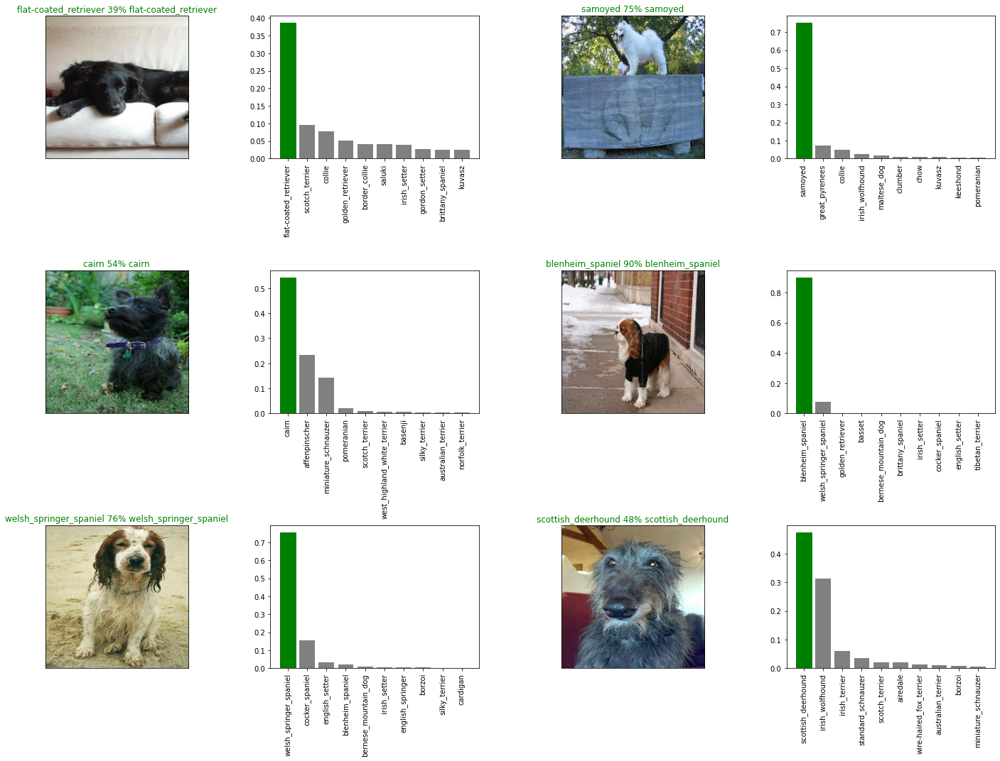

In [ ]:
# Check predictions and their different values 
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)

plt.tight_layout(h_pad=1.0)
plt.show()

## Saving and reloading a trained model 

In [ ]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a models directory with current time 
  modeldir = os.path.join("drive/MyDrive/Dog Vision/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path


In [ ]:
# Create a function load a trained model 
def load_model(model_path):
  """
  Loads a saved model from a specified path
  """
  print(f"Loading a saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer": hub.KerasLayer})
  return model

Now we have functions to load and save a trained model we will test these

In [ ]:
# Save our model trained on 1000 images 
save_model(model, suffix="1000-images-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20210130-07561611993378-1000-images-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog Vision/models/20210130-07561611993378-1000-images-mobilenetv2-Adam.h5'

In [ ]:
# Load a trained model 
loaded_1000_image_model = load_model("drive/MyDrive/Dog Vision/models/20210128-02101611799815-1000-images-mobilenetv2-Adam.h5")

Loading a saved model from: drive/MyDrive/Dog Vision/models/20210128-02101611799815-1000-images-mobilenetv2-Adam.h5


In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

7/7 [==============================] - 1s 105ms/step - loss: 1.3118 - accuracy: 0.6400


[1.3118271827697754, 0.6399999856948853]

In [ ]:
# Evaluate the loaded model 
loaded_1000_image_model.evaluate(val_data)

7/7 [==============================] - 1s 106ms/step - loss: 1.3118 - accuracy: 0.6400


[1.3118271827697754, 0.6399999856948853]

## Training a model on the full data

In [ ]:
len(X), len(y)

(10222, 10222)

In [ ]:
# Create a data batch with the full dataset
full_data = create_data_batches(X, y)

Creating training data batches...


In [ ]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# Create a model for full model
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# Create full model callbacks
full_model_tensorboard = create_tensorboard_callback()

# No validation set when training on all of the data, so we can't monitor validation accuracy 
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)



**Note:** Running the cell below will take a little while (maybe up to 30 minutes for the first epoch) because the GPU we're using in the runtime has to load all of the images into memory. 

In [ ]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=100,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 4259s 13s/step - loss: 2.3250 - accuracy: 0.4987
Epoch 2/100
320/320 [==============================] - 55s 171ms/step - loss: 0.3918 - accuracy: 0.8833
Epoch 3/100
320/320 [==============================] - 54s 168ms/step - loss: 0.2234 - accuracy: 0.9424
Epoch 4/100
320/320 [==============================] - 46s 144ms/step - loss: 0.1567 - accuracy: 0.9619
Epoch 5/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0967 - accuracy: 0.9802
Epoch 6/100
320/320 [==============================] - 51s 159ms/step - loss: 0.0734 - accuracy: 0.9857
Epoch 7/100
320/320 [==============================] - 54s 170ms/step - loss: 0.0580 - accuracy: 0.9918
Epoch 8/100
320/320 [==============================] - 54s 167ms/step - loss: 0.0429 - accuracy: 0.9942
Epoch 9/100
320/320 [==============================] - 50s 155ms/step - loss: 0.0328 - accuracy: 0.9977
Epoch 10/100
320/320 [==============================] - 49s 152m

In [ ]:
save_model(full_model, suffix="full-image-set-mobilenetv2-Adam")

Saving model to: drive/MyDrive/Dog Vision/models/20210128-07051611817557-full-image-set-mobilenetv2-Adam.h5...


'drive/MyDrive/Dog Vision/models/20210128-07051611817557-full-image-set-mobilenetv2-Adam.h5'

In [ ]:
loaded_full_model = load_model("drive/MyDrive/Dog Vision/models/20210128-07051611817557-full-image-set-mobilenetv2-Adam.h5")

Loading a saved model from: drive/MyDrive/Dog Vision/models/20210128-07051611817557-full-image-set-mobilenetv2-Adam.h5


## Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format. 

To make predictions on the test data, we'll: 
* Get the test images filenames 
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since the test data doesn't have labels). 
* Make a predictions array by passing the test batches to the `predict()` method called on our model. 

In [ ]:
# Load test image filenames 
test_path = "drive/MyDrive/Dog Vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]
test_filenames[:10]


['drive/MyDrive/Dog Vision/test/eb407d16321c8cb62abd16c70756a28a.jpg',
 'drive/MyDrive/Dog Vision/test/eb44625ed1113825fe1f23e50222cca1.jpg',
 'drive/MyDrive/Dog Vision/test/f04afba75c6b505c74c9958aa8aabffa.jpg',
 'drive/MyDrive/Dog Vision/test/ea8669c09612478bfa202ae2fa101b13.jpg',
 'drive/MyDrive/Dog Vision/test/f58a21665136bb6aa4aa90c485be4315.jpg',
 'drive/MyDrive/Dog Vision/test/e857866af777793d2c114b09ea7a685a.jpg',
 'drive/MyDrive/Dog Vision/test/e9d385cf5f217ce1378bee8c0a89db62.jpg',
 'drive/MyDrive/Dog Vision/test/ea5a2c10729ab1ffec74c0aabce02b52.jpg',
 'drive/MyDrive/Dog Vision/test/ea5ae600ca3996528b6548eceac767cf.jpg',
 'drive/MyDrive/Dog Vision/test/f16cb4716034cecf3edd7260109fdf17.jpg']

In [ ]:
len(test_filenames)

10357

In [ ]:
# Create test data batch 
test_data = create_data_batches(test_filenames, test_data=True)


Creating test data batches...


In [ ]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

**Note:** Calling `predict()` on our full model and passing it the test data batch will take a long time to run. 
(About ~1 Hour) 

In [ ]:
# Make predictions on test data batch using the loaded full model 
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 5910s 18s/step


In [ ]:
# Save predictions (NumPy array) to csv file (for access later) 
np.savetxt("drive/MyDrive/Dog Vision/preds_array.csv", test_predictions, delimiter=",")

In [ ]:
# Load predictions (NumPy array) from csv file 
test_predictions = np.loadtxt("drive/MyDrive/Dog Vision/preds_array.csv", delimiter=",")

In [ ]:
test_predictions[:10]

array([[4.56571598e-07, 4.86558660e-09, 1.37967152e-13, ...,
        2.76579920e-13, 1.82177095e-13, 9.43630956e-14],
       [5.53679010e-13, 7.90347843e-10, 2.41581403e-14, ...,
        6.93262159e-09, 1.93060787e-05, 1.26205817e-11],
       [4.41290103e-06, 3.03731137e-11, 4.28765252e-11, ...,
        1.85157958e-10, 2.35355138e-12, 2.80285201e-14],
       ...,
       [4.18814398e-06, 3.11642580e-05, 1.43660429e-07, ...,
        4.17898516e-09, 4.06703364e-08, 3.85832415e-08],
       [9.99674082e-01, 1.97784455e-10, 8.69853235e-12, ...,
        3.93679447e-12, 7.32945260e-09, 4.71823514e-09],
       [6.10599713e-08, 1.12838592e-08, 7.32042536e-05, ...,
        9.36934885e-06, 7.62361515e-06, 6.72528928e-04]])

## Preparing the test dataset predictions for Kaggle 

Looking at the Kaggle sample submission, we find that it wants our models prediction probability outputs in a DataFrame with ID Column and a column for each different dog breed.

https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

To get the data in this format, we'll: 
* Create a pandas DataFrame with an ID column as well as a column for each dog breed 
* Add data to the ID column by extracting the test image ID's from their filepaths 
* Add data (the prediction probabilities) to each of the dog breed columns. 
* Export the DataFrame as a CSV to submit it to Kaggle. 

In [ ]:
# Create a pandas DataFrame with empty columns 
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))

preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image ID's to predictions DataFrame
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df["id"] = test_ids

In [ ]:
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,eb407d16321c8cb62abd16c70756a28a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,eb44625ed1113825fe1f23e50222cca1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,f04afba75c6b505c74c9958aa8aabffa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,ea8669c09612478bfa202ae2fa101b13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,f58a21665136bb6aa4aa90c485be4315,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the prediction probabilities to each dog breed column 
preds_df[list(unique_breeds)] = test_predictions 
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,eb407d16321c8cb62abd16c70756a28a,4.56572e-07,4.86559e-09,1.37967e-13,1.9633e-11,1.2415e-08,1.6723e-11,6.62557e-11,4.00387e-11,2.25666e-11,1.32388e-14,1.03029e-12,4.81527e-09,6.38324e-11,9.89741e-11,3.04706e-08,3.64841e-12,1.30201e-07,1.89161e-12,4.95384e-11,2.68388e-13,9.57465e-08,1.72374e-10,2.97451e-12,2.70162e-09,2.25925e-12,1.36859e-09,2.0537e-14,1.07069e-11,2.27632e-08,1.1636e-12,2.40849e-07,1.16218e-12,1.29845e-08,6.88818e-10,5.48984e-09,7.89476e-13,5.32963e-10,4.04376e-10,4.47573e-11,...,6.73468e-10,1.08501e-11,4.53117e-11,5.52089e-09,1.63507e-11,4.56708e-10,1.52064e-12,1.60935e-10,1.24634e-09,1.92169e-09,1.79549e-09,1.18525e-07,1.09097e-07,5.26005e-10,1.05645e-07,1.24606e-06,8.58436e-12,3.85417e-10,5.05554e-12,5.88965e-10,3.16498e-08,4.20847e-07,6.69498e-16,5.52894e-12,1.64075e-10,1.17177e-06,4.77996e-09,1.80144e-12,7.43366e-07,9.90685e-12,4.3671e-12,7.29548e-11,1.19794e-11,1.35115e-11,2.83649e-09,2.93432e-14,1.04246e-11,2.7658e-13,1.82177e-13,9.43631e-14
1,eb44625ed1113825fe1f23e50222cca1,5.53679e-13,7.90348e-10,2.41581e-14,0.999265,1.00637e-10,6.94409e-10,1.81399e-09,7.00652e-11,5.92937e-13,5.14575e-14,9.86774e-10,2.90041e-13,4.83137e-10,6.85843e-14,9.33755e-12,2.54072e-11,1.88777e-11,5.34856e-08,5.45768e-12,1.85351e-13,3.2555e-15,2.78313e-11,8.49725e-12,4.86356e-11,8.96282e-10,4.72175e-12,1.53128e-13,3.05342e-15,1.08072e-06,1.98405e-14,1.54588e-11,1.45197e-12,3.65751e-13,4.14308e-10,9.90141e-09,4.12631e-13,7.75413e-11,1.80209e-12,2.34578e-10,...,2.57699e-13,1.45732e-11,1.4205e-12,2.43326e-08,1.27618e-12,3.86973e-13,7.7378e-11,1.34947e-12,3.60043e-14,7.25148e-09,1.27027e-09,3.00812e-12,2.98045e-11,1.68992e-12,2.43046e-14,2.95886e-14,1.81653e-12,3.12711e-09,1.7581e-11,3.75421e-12,2.73893e-14,2.25834e-13,4.28735e-13,2.98227e-10,1.65445e-10,2.64185e-05,7.07907e-09,5.02828e-12,2.32568e-13,2.23861e-14,1.19765e-10,3.47618e-12,7.30816e-07,2.67621e-09,6.18589e-12,2.89087e-11,3.15714e-14,6.93262e-09,1.93061e-05,1.26206e-11
2,f04afba75c6b505c74c9958aa8aabffa,4.4129e-06,3.03731e-11,4.28765e-11,1.63426e-09,5.42937e-12,1.4012e-09,9.64996e-08,3.24401e-11,1.18632e-12,7.95491e-15,3.92297e-12,2.52944e-07,1.57748e-10,3.24065e-15,1.75282e-11,8.13525e-11,4.41863e-06,3.46496e-12,2.70282e-11,1.90355e-09,5.11348e-09,1.69086e-14,2.39507e-10,1.91732e-12,6.85838e-11,2.50884e-11,2.85525e-10,1.58882e-11,1.43847e-07,9.96115e-11,6.26414e-07,1.20522e-11,5.2679e-09,2.71524e-07,1.04189e-06,5.92e-12,1.0818e-08,3.63081e-10,3.14024e-10,...,4.8732e-07,6.06162e-12,1.82058e-13,4.28805e-12,3.9419e-08,3.99521e-13,4.33787e-09,2.07761e-07,1.36533e-08,9.48331e-08,6.15381e-10,2.68862e-11,6.12353e-11,1.72262e-11,3.92659e-08,0.0041111,1.8867e-09,2.73047e-08,6.58504e-12,2.68184e-10,5.34987e-11,2.13138e-09,1.75083e-14,1.28884e-08,2.07797e-08,5.56899e-06,3.71994e-10,1.56045e-12,1.41548e-05,1.97681e-11,8.9709e-11,6.7353e-10,2.05447e-11,7.62461e-13,2.07709e-10,4.04572e-12,5.8626

In [ ]:
# Save our predictions dataframe to CSV for submission to Kaggle
preds_df.to_csv("drive/MyDrive/Dog Vision/full_model_predictions_submission_1_mobilenetv2.csv",
                index=False)

# Make some predictions on custom images

To make predictions on custom images, we'll 
* Get the filepaths of our own images. 
* Turn the filepaths into data batches using `create_data_batches`. And since our custom images won't have labels, we set the `test_data` parameter to `True`. 
* Pass the custom image data batch to our model's `predict()` method. 
* Convert the prediction output probabilities to predictions labels. 
* Compare the predicted labels to the custom images. 

In [ ]:
# Get custom image filepaths 
custom_path = "drive/MyDrive/Dog Vision/personal-photos/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
custom_image_paths

['drive/MyDrive/Dog Vision/personal-photos/141709282_1748596825306355_6763134733681513140_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/136057809_1774537176042902_3724576477565960659_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/134723365_224882735840101_7537367633326051017_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/141816093_867279550509194_3282643412967036934_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/141447285_162586608714617_8436731796077787467_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/136157713_311578493563921_7718220305109098307_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/141560876_3709333469125202_3407629842452538302_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/141341298_454349689071744_5247811280201354608_n.jpg',
 'drive/MyDrive/Dog Vision/personal-photos/142396574_466567494337769_4119632185971956183_n.jpg']

In [ ]:
# Turn custom images into batch datasets 
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches...


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

In [ ]:
custom_preds.shape

(9, 120)

In [ ]:
# Get custom image prediction labels 
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['west_highland_white_terrier',
 'west_highland_white_terrier',
 'samoyed',
 'french_bulldog',
 'pembroke',
 'wire-haired_fox_terrier',
 'standard_poodle',
 'american_staffordshire_terrier',
 'samoyed']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data 
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

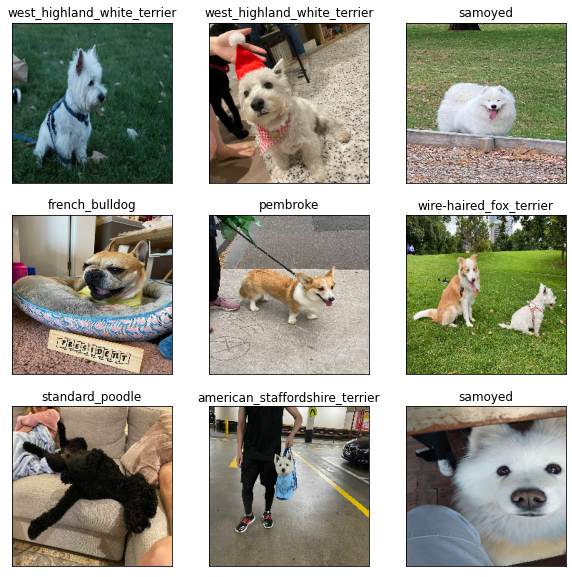

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(3, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)